### Note: This is separated so I don't step on your guy's toes during development. This can be merged in the EDA notebook once we're all done

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
from utils import primary_dataset
import plotly.express as px
import folium
from branca.colormap import linear


In this notebook, I will conduct EDA on the features available via the EY AI competition. Those being `nir`, `green`, `swir16`, `swir22`, `ndmi`, and `mndwi`

Here's a quick refresher on what each variable means (Taken from `SustainableWaterQualityNotebook.ipynb`):
- **SWIR22** – Sensitive to surface moisture and turbidity variations in water bodies.  
- **NIR** – Helps in identifying vegetation and suspended matter in water.  
- **Green** – Useful for detecting water color and surface reflectance changes.  
- **SWIR16** – Provides information on surface dryness and sediment concentration.  
- **NDMI** – Derived from NIR and SWIR16, indicates moisture and vegetation–water interaction.  
- **MNDWI** – Derived from Green and SWIR22, effective for distinguishing open water areas and reducing built-up noise.  

In [2]:
water_quality_df = pd.read_csv('data/wq.csv')
features = ['nir', 'green', 'swir16', 'swir22', 'ndmi', 'mndwi']
water_quality_df.head(10)

,province,country,latitude,longitude,sample date,nir,green,swir16,swir22,ndmi,...,total alkalinity,electrical conductance,dissolved reactive phosphorus,month,sample_year,pop_density_nn,distance_km_to_pd_cell,river_mouthORjunction,river_mouth,river_junction
0,Mpumalanga,South Africa,-26.861111,28.884722,2011-01-03,17658.5,9550.0,13746.5,10574.0,0.124566,...,74.720,162.9,163.0,2011-01-31,2011,5.049022,0.251555,0,0,0
1,Gauteng,South Africa,-26.450000,28.085833,2011-01-03,15210.0,10720.0,17974.0,14201.0,-0.083293,...,89.254,573.0,80.0,2011-01-31,2011,23.239988,0.419537,0,0,0
2,Free State,South Africa,-27.671111,27.236944,2011-01-03,14887.0,10943.0,13522.0,11403.0,0.048048,...,82.000,203.6,101.0,2011-01-31,2011,687.465759,0.069958,0,0,0
3,Free State,South Africa,-27.356667,27.286389,2011-01-03,16828.5,9502.5,12665.5,9643.0,0.141147,...,56.100,145.1,151.0,2011-01-31,2011,6.092811,0.232396,0,0,0
4,Free State,South Africa,-27.010111,26.698083,2011-01-04,12433.5,10433.5,9579.5,8531.5,0.129651,...,82.200,289.8,192.0,2011-01-31,2011,77.849716,0.466183,0,0,0
5,North West,South Africa,-25.127778,27.628889,2011-01-04,7814.0,5189.5,6664.0,5222.0,0.079431,...,125.000,438.0,163.0,2011-01-31,2011,3.473888,0.223439,0,0,0
6,North West,South Africa,-25.206390,27.558000,2011-01-04,14137.5,10466.5,10315.5,8536.0,0.156300,...,116.620,568.0,69.0,2011-01-31,2011,6.692756,0.383396,0,0,0
7,Limpopo,South Africa,-24.695140,27.409060,2011-01-04,15543.0,10647.0,11919.5,9642.5,0.131944,...,181.831,583.0,158.0,2011-01-31,2011,2.950710,0.253047,0,0,0
8,North West,South Africa,-26.984722,26.632278,2011-01-04,13683.0,10207.0,14011.5,11850.5,-0.011862,...,196.000,452.0,158.0,2011-01-31,2011,7.390572,0.529907,0,0,0
9,Free State,South Africa,-28.141944,26.417778,2011-01-04,14391.0,9840.0,13799.5,11265.0,0.020982,...,94.718,227.9,132.0,2011-01-31,2011,9.564678,0.481920,0,0,0


At a base level, let's take a look at some descriptive stastics of these columns

In [13]:
desc_df = pd.DataFrame(columns=["feature", "count", "mean", "std", "min", "25%", "median", "75%", "max"])

for feature in features:
    desc_df.loc[len(desc_df)] = ([feature] + list(water_quality_df[feature].describe()))
desc_df

,feature,count,mean,std,min,25%,median,75%,max
0,nir,9093.0,14076.357143,2781.388056,3992.000000,12989.000000,14183.000000,15306.000000,65535.000000
1,green,9093.0,9953.711096,2636.001818,4045.000000,9431.500000,9801.000000,10202.000000,65535.000000
2,swir16,9093.0,13602.848317,3155.115173,3672.500000,12100.500000,13704.250000,15196.000000,65535.000000
3,swir22,9093.0,11414.898686,2403.320108,3634.000000,10049.500000,11265.250000,12650.000000,31202.500000
4,ndmi,9093.0,0.021194,0.073279,-0.328293,-0.027309,0.021549,0.065376,0.567905
5,mndwi,9093.0,-0.148254,0.090995,-0.300487,-0.206646,-0.167901,-0.119244,0.590974


Here, it looks like `nir`, `swir16`, and `swir22` seem to share similar descriptive statistics. This makes sense since they deal with reflectance in the infrared wavelengths. This can open up the possibility of them being correlated with eachother, which would be detrimental to model training. Additionally, since `ndmi` and `mndwi` are based on other landsat features, it would be reasonable to check for collinearity.

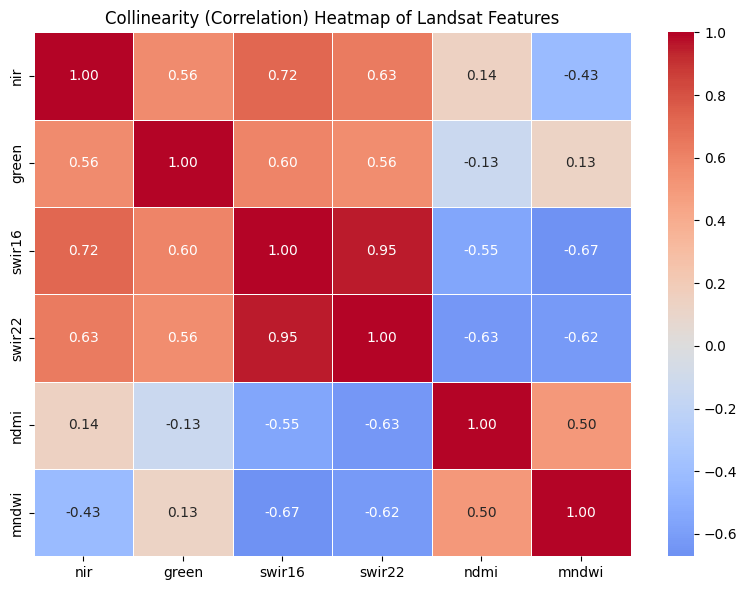

In [14]:
feature_df = water_quality_df[features]
collinearity_matrix = feature_df.corr()

# Set plot size
plt.figure(figsize=(8, 6))

# Create heatmap
sns.heatmap(
    collinearity_matrix,
    annot=True,
    cmap='coolwarm',
    center=0,
    fmt=".2f",
    linewidths=0.5
)

plt.title("Collinearity (Correlation) Heatmap of Landsat Features")
plt.tight_layout()
plt.show()

One important thing to note is the high correlation of 0.95 between `swir16` and `swir22`. This can be expected since they deal with very close wavelengths (1.6 and 2.2 micrometers). Because of the high correlation between the two, it would be reasonable (and much more efficient) to keep only one of these features to reduce redundancy. Let's keep `swir16`

Another important note is the lower correlations of `ndmi` and `mndwi` on the other landsat features. This indicates that even though they may be based on the other features, they carry nonlinear information that could be useful for model training.

Based on this analysis of collinearity, we can drop `swir16` and keep the other features

In [15]:
feature_df = feature_df.drop(["swir16"], axis=1)
feature_df

,nir,green,swir22,ndmi,mndwi
0,17658.5,9550.0,10574.0,0.124566,-0.180134
1,15210.0,10720.0,14201.0,-0.083293,-0.252805
2,14887.0,10943.0,11403.0,0.048048,-0.105416
3,16828.5,9502.5,9643.0,0.141147,-0.142683
4,12433.5,10433.5,8531.5,0.129651,0.042672
...,...,...,...,...,...
9088,15296.5,10043.0,14443.0,-0.034236,-0.239858
9089,15642.5,10294.5,14710.0,-0.042921,-0.246928
9090,14945.0,10732.0,16281.0,-0.100999,-0.260754
9091,14727.5,11051.0,15724.5,-0.111396,-0.250042


## Wavelength features (`nir`, `green`, `swir22`)

According to NASA, these Landsat features measure the brightness or reflectance of certain areas of Earth's surface towards the satellite. The reason why they have a max value of 65535 is due to their recent launch of Landsat 8, which encodes this brightness into a 16 bit integer (Max value of 16-bit integer is 65536). These features measure the brightness at various wavelengths in the EM spectrum:
- `green`: 530 - 590 nm
- `nir`: 850 - 880 nm
- `swir22`: 2100 - 2300 nm

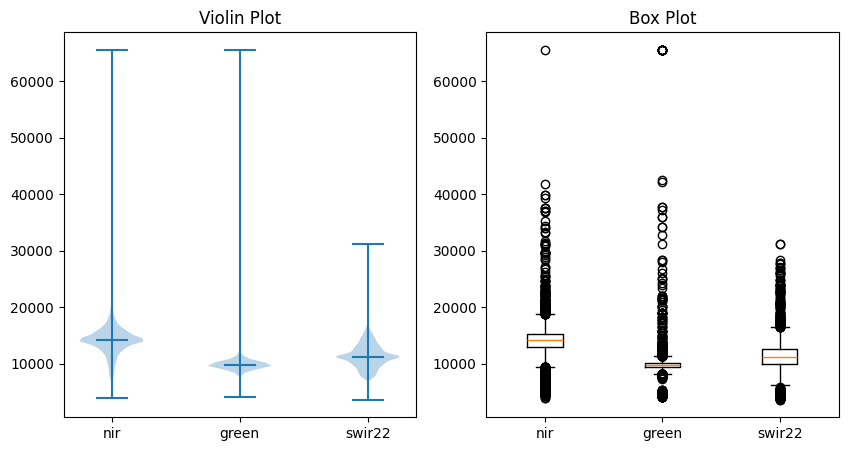

In [17]:
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
cols = ["nir", "green", "swir22"]

# Violin plot
axs[0].violinplot(feature_df[cols], showmedians=True)
axs[0].set_xticks([1, 2, 3])
axs[0].set_xticklabels(cols)
axs[0].set_title("Violin Plot")

# Box plot
axs[1].boxplot(feature_df[cols])
axs[1].set_xticks([1, 2, 3])
axs[1].set_xticklabels(cols)
axs[1].set_title("Box Plot")


plt.show()

#### Observation
Although the range is extensive for all of the wavelength reflectance features, it seems that the majority of samples fall within a much smaller range, with a large number of outliers. This is to be expected, as clouds, which can get in the way of satellite readings, have very high reflectance. Additionally, most of Earth's surfaces can reflect light in various ways, which can lead to a skewed distribution. To better understand the distribution of the wavelength reflectance features, let's try using a log scale.

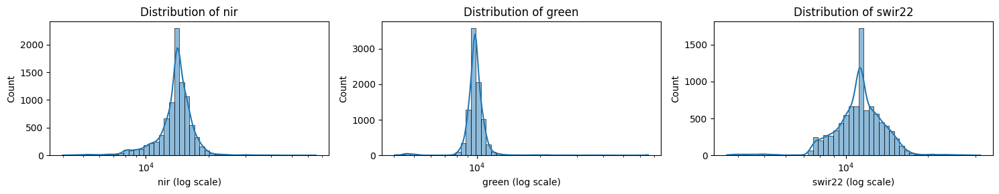

In [46]:
fig, axs = plt.subplots(1,3, figsize=(15, 3))

wl_features = ["nir", "green", "swir22"]

for i in range(len(wl_features)):
    feature = wl_features[i]
    sns.histplot(
        water_quality_df[feature],
        bins=50,
        kde=True,
        ax=axs[i],
        log_scale=True
    )

    axs[i].set_xlabel(f"{feature} (log scale)")
    axs[i].set_title(f"Distribution of {feature}")
    
plt.tight_layout()
plt.show()

#### Observation
All 3 of the wavelength reflectance features seem to have a unimodal distribution when viewed from a log-scale perspective. They also cluster tightly around a narrow range, indicating most samples having similar wavelength reflectances. There are also extreme readings that can explain the right-tail in all the wavelength features. Let's analyze them one by one in a spatial sense

### Near infrared reflectance: `nir`

In [6]:
# --- Prep data (same logic as your matplotlib version) ---
df = water_quality_df.copy()
df.columns = df.columns.str.strip().str.lower()

# keep only what we need
df = df[["latitude","longitude","nir"]].dropna()
df[["latitude","longitude","nir"]] = df[["latitude","longitude","nir"]].apply(pd.to_numeric, errors="coerce")
df = df.dropna()

# log transform
df["nir_log"] = np.log10(df["nir"])
vmin = df["nir_log"].quantile(0.01)
vmax = df["nir_log"].quantile(0.99)

cmap = linear.viridis.scale(vmin, vmax)
cmap.caption = "nir (log10)"

m = folium.Map(location=[df.latitude.mean(), df.longitude.mean()], zoom_start=5, tiles="CartoDB positron")

for _, r in df.iterrows():
    val = float(np.clip(r["nir_log"], vmin, vmax))
    folium.CircleMarker(
        location=[r["latitude"], r["longitude"]],
        radius=4,
        color=cmap(val),
        fill=True,
        fill_color=cmap(val),
        fill_opacity=0.8,
        weight=0.5,
        tooltip=f"NIR: {r['nir']:.1f} | log10: {r['nir_log']:.2f}"
    ).add_to(m)

cmap.add_to(m)
m

#### Observation
The spatial distribution of log-scaled NIR throughout 

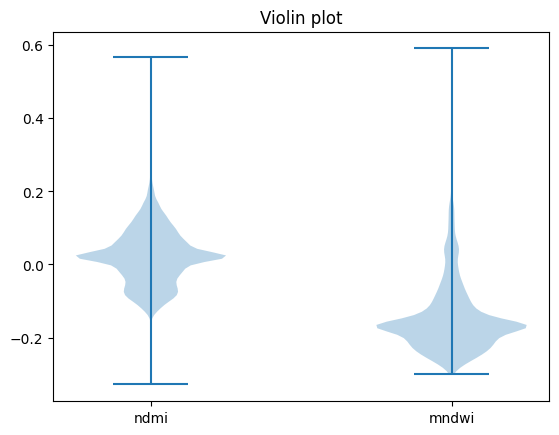

In [20]:

cols = ["ndmi", "mndwi"]
plt.violinplot(water_quality_df[cols])
plt.title("Violin plot")
plt.xticks([1, 2], cols)
plt.show()

### Observation

### Normalized Difference Moisture Index: `ndmi`

In [10]:
df = water_quality_df.copy()
vmin = df["ndmi"].quantile(0.01)
vmax = df["ndmi"].quantile(0.99)

cmap = linear.viridis.scale(vmin, vmax)
cmap.caption = "NDMI"

m = folium.Map(location=[df.latitude.mean(), df.longitude.mean()], zoom_start=5, tiles="CartoDB positron")

for _, r in df.iterrows():
    val = float(np.clip(r["ndmi"], vmin, vmax))
    folium.CircleMarker(
        location=[r["latitude"], r["longitude"]],
        radius=4,
        color=cmap(val),
        fill=True,
        fill_color=cmap(val),
        fill_opacity=0.8,
        weight=0.5,
        tooltip=f"NDMI: {r['ndmi']:.2f}"
    ).add_to(m)

cmap.add_to(m)
m

### Observation
The spatial distribution of the NDMI throughout South Africa has some regional influences. A reasonable inference is that the NDMI seemingly is higher (Indicated by the more lighter dots) around coastal regions such as the Western Cape and Kwazulu-Natal, but lower towards the interior of South Africa. This is to be expected, as these regions typically experience much more rainfall and have a higher amount of vegetation, which is what NDMI measures. Because of this, higher NDMI can be attributed to areas with more rainfall, which could be considered higher quality water. As a next step, the influence of NDMI on the various water quality indicators (Alkalinity, conductance, dissolved phosphorus).

### Modified Normalized Difference Water Index: `mndwi`

In [11]:
df = water_quality_df.copy()
vmin = df["mndwi"].quantile(0.01)
vmax = df["mndwi"].quantile(0.99)

cmap = linear.viridis.scale(vmin, vmax)
cmap.caption = "NDMI"

m = folium.Map(location=[df.latitude.mean(), df.longitude.mean()], zoom_start=5, tiles="CartoDB positron")

for _, r in df.iterrows():
    val = float(np.clip(r["mndwi"], vmin, vmax))
    folium.CircleMarker(
        location=[r["latitude"], r["longitude"]],
        radius=4,
        color=cmap(val),
        fill=True,
        fill_color=cmap(val),
        fill_opacity=0.8,
        weight=0.5,
        tooltip=f"MNDWI: {r['mndwi']:.2f}"
    ).add_to(m)

cmap.add_to(m)
m